<a href="https://colab.research.google.com/github/UMB200/AI_ML_pytorch_projects/blob/main/07_pytorch_experiment_tracking.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 07 Pytorch Experiment Tracking

This notebook demonstrates how to track machine learning experiments using PyTorch and TensorBoard.

**Technologies and Libraries Used:**

*   **PyTorch:** A deep learning framework for building and training neural networks.
*   **Torchvision:** A library for computer vision tasks, providing datasets, models, and transformations.
*   **TensorBoard:** A visualization toolkit for machine learning experiments.
*   **Matplotlib:** A plotting library for creating visualizations.
*   **torchinfo:** Provides model summary information.
*   **modular_helpers:** Custom helper scripts for data setup, model training, and utility functions.

**ML Algorithms and Concepts:**

*   **Transfer Learning:** Using a pre-trained EfficientNetB0 and EfficientNetB2 model and adapting it to a new task (image classification of pizza, steak, and sushi).
*   **Feature Extractor:** Freezing the base layers of the pre-trained model and training only the classifier head.
*   **Experiment Tracking:** Using TensorBoard to log and visualize training and testing metrics (loss and accuracy) for different model configurations (EfficientNetB0 vs EfficientNetB2), dataset sizes (10% vs 20%), and training epochs (5 vs 10).

**Main Code Functions:**

*   `download_data`: Downloads data from a given source.
*   `create_dataloaders`: Creates PyTorch DataLoaders for training and testing.
*   `set_rand_seed`: Sets the random seed for reproducibility.
*   `train_step_loop`: Performs a single training step.
*   `test_step_loop`: Performs a single testing step.
*   `train_with_writer`: Trains a model and logs metrics to a TensorBoard SummaryWriter.
*   `create_tensorwriter`: Creates a TensorBoard SummaryWriter instance with a structured log directory.
*   `feature_extractor`: Modifies a pre-trained model to be used as a feature extractor.
*   `save_model`: Saves a PyTorch model to a file.
*   `predict_show_image_fn`: Makes a prediction on an image and displays the result.


## 1.0 Install necessary libraries

In [ ]:
import torch
import torchvision
import matplotlib.pyplot as plt
from torch import nn
from torchvision import transforms
import os
import zipfile
import sys
from pathlib import Path
from torch.utils.tensorboard import SummaryWriter

from timeit import default_timer as timer
from typing import Dict, List, Tuple

import tqdm.auto as tqdm
from tqdm.auto import tqdm

import tensorflow as tf # used in #208

import datetime
from datetime import datetime # used in 209

from PIL import Image
import random
import requests # used in 220

try:
  from torchinfo import summary
except:
  !pip install torchinfo
  from torchinfo import summary

try:
  from modular_helpers import data_setup, set_rand_seed, download_data
  from modular_helpers.engine import train_step_loop, test_step_loop
  from modular_helpers.utils import save_model
except:
  print("No helper scripts are found, downloading")
  !git clone https://github.com/UMB200/pytorch_projects.git
  if not os.path.exists('/content/modular_helpers'):
    !mkdir /content/modular_helpers
  !mv /content/pytorch_projects/modular_helpers/* /content/modular_helpers

  !rm -rf /content/pytorch_projects

  sys.path.insert(0, '/content/modular_helpers')
  from modular_helpers import data_setup, set_rand_seed, download_data
  from modular_helpers.engine import train_step_loop, test_step_loop
  from modular_helpers.utils import save_model


#print(f"torch version: {torch.__version__}")
#print(f"torchvision version: {torchvision.__version__}")

No helper scripts are found, downloading
Cloning into 'pytorch_projects'...
remote: Enumerating objects: 221, done.
remote: Counting objects: 100% (60/60), done.
remote: Compressing objects: 100% (59/59), done.
remote: Total 221 (delta 33), reused 0 (delta 0), pack-reused 161 (from 1)
Receiving objects: 100% (221/221), 4.96 MiB | 10.98 MiB/s, done.
Resolving deltas: 100% (120/120), done.


In [ ]:
#!rm -rf /content/modular_helpers

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"
device

'cpu'

In [ ]:
set_rand_seed.set_rand_seed()

## 1.1 Get data

In [ ]:
image_path = download_data.download_data(source="https://github.com/mrdbourke/pytorch-deep-learning/raw/main/data/pizza_steak_sushi.zip",
                      destination="pizza_steak_sushi")

No data/pizza_steak_sushi dir is found, creating one


## 2.0 Create Datasets and DataLoaders

### 2.0.1 Setup training and testing directories

In [ ]:
train_dir = image_path / "train"
test_dir = image_path / "test"

### 2.1 Create DataLoaders with manual transformations

In [ ]:
# Setup ImageNet normalization levels (turns all images into similar distribution as ImageNet)
normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                 std=[0.229, 0.224, 0.225])

# Create transform pipeline manually
manual_transforms = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    normalize
])
print(f"Manually created transforms: {manual_transforms}")

Manually created transforms: Compose(
    Resize(size=(224, 224), interpolation=bilinear, max_size=None, antialias=True)
    ToTensor()
    Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
)


In [ ]:
# Create data loaders
train_dataloader, test_dataloader, class_names = data_setup.create_dataloaders(
    train_dir=train_dir,
    test_dir=test_dir,
    transform=manual_transforms, # use manually created transforms
    batch_size=32
)

train_dataloader, test_dataloader, class_names

(<torch.utils.data.dataloader.DataLoader at 0x79457f71c230>,
 ['pizza', 'steak', 'sushi'])

### 2.2 Create DataLoaders with auto transforms

In [ ]:
weights_eff_net = torchvision.models.EfficientNet_B0_Weights.DEFAULT
auto_transforms = weights_eff_net.transforms()

train_dataloader, test_dataloader, class_names = data_setup.create_dataloaders(
    train_dir = train_dir,
    test_dir = test_dir,
    transform = auto_transforms,
    batch_size = 32)

train_dataloader, test_dataloader, class_names

(<torch.utils.data.dataloader.DataLoader at 0x79457f71e000>,
 ['pizza', 'steak', 'sushi'])

## 3.0 Getting pre-trained model, freezing the base layers and change the classfier head

In [ ]:
pretrained_model_0 = torchvision.models.efficientnet_b0(weights=weights_eff_net).to(device)

Downloading: "https://download.pytorch.org/models/efficientnet_b0_rwightman-7f5810bc.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b0_rwightman-7f5810bc.pth


100%|██████████| 20.5M/20.5M [00:00<00:00, 107MB/s] 


In [ ]:
for param in pretrained_model_0.features.parameters():
  param.requires_grad = False

In [ ]:
pretrained_model_0.classifier = nn.Sequential(
    nn.Dropout(p=0.2, inplace=True),
    nn.Linear(in_features=1280, out_features=len(class_names), bias=True)
).to(device)

pretrained_model_0.classifier

Sequential(
  (0): Dropout(p=0.2, inplace=True)
  (1): Linear(in_features=1280, out_features=3, bias=True)
)

## 4.0 Train model and track results

In [ ]:
loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(pretrained_model_0.parameters(), lr=0.001)

In [ ]:
tensorboard_writer = SummaryWriter()

In [ ]:
from modular_helpers.engine import train_step_loop, test_step_loop

def train_with_writer(model: torch.nn.Module,
               train_dataloader: torch.utils.data.DataLoader,
               test_dataloader: torch.utils.data.DataLoader,
               optimizer: torch.optim.Optimizer,
               loss_fn: torch.nn.Module,
               epochs: int,
               device: torch.device)-> Dict[str, List]:

  results = {"train_loss": [],
             "train_acc": [],
             "test_loss": [],
             "test_acc": []}
  for epoch in tqdm(range(epochs)):
    train_loss, train_acc = train_step_loop(model=model,
                                            data_loader=train_dataloader,
                                            loss_fn=loss_fn,
                                            optimizer=optimizer,
                                            device=device)
    test_loss, test_acc = test_step_loop(model=model,
                                        data_loader=test_dataloader,
                                        loss_fn=loss_fn,
                                         device=device)
    print(f"Epoch: {epoch+1} | "
          f"train_loss: {train_loss:.4f} | "
          f"train_acc: {train_acc:.4f} | "
          f"test_loss: {test_loss:.4f} | "
          f"test_acc: {test_acc:.4f}")
    get_tensor_val = lambda x: x.item() if isinstance(x, torch.Tensor) else x
    results["train_loss"].append(get_tensor_val(train_loss))
    results["train_acc"].append(get_tensor_val(train_acc))
    results["test_loss"].append(get_tensor_val(test_loss))
    results["test_acc"].append(get_tensor_val(test_acc))

    tensorboard_writer.add_scalars(main_tag="Loss",
                                    tag_scalar_dict={"train_loss": train_loss,
                                                    "test_loss": test_loss},
                                    global_step=epoch)
    tensorboard_writer.add_scalars(main_tag="Accuracy",
                                    tag_scalar_dict={"train_acc": train_acc,
                                                    "test_acc": test_acc},
                                    global_step=epoch)
    tensorboard_writer.add_graph(model=pretrained_model_0,
                                 input_to_model=torch.randn(32, 3, 224, 224).to(device))
  tensorboard_writer.close()

  return results

In [ ]:
res_0 = train_with_writer(model=pretrained_model_0,
              train_dataloader=train_dataloader,
              test_dataloader=test_dataloader,
              loss_fn=loss_fn,
              optimizer=optimizer,
              epochs=5,
              device=device)

  0%|          | 0/5 [00:00<?, ?it/s]

/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:666: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)


Epoch: 1 | train_loss: 1.0301 | train_acc: 0.4688 | test_loss: 0.8117 | test_acc: 0.8561
Epoch: 2 | train_loss: 0.8934 | train_acc: 0.6367 | test_loss: 0.6279 | test_acc: 0.8854
Epoch: 3 | train_loss: 0.7461 | train_acc: 0.8398 | test_loss: 0.6609 | test_acc: 0.8759
Epoch: 4 | train_loss: 0.6956 | train_acc: 0.7305 | test_loss: 0.6489 | test_acc: 0.8153
Epoch: 5 | train_loss: 0.5988 | train_acc: 0.7773 | test_loss: 0.5350 | test_acc: 0.9375


## 5.0 View model results in TensorBoard

In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

## 6.0 Create a helper function to build `SummaryWriter` instances

In [ ]:
def create_tensorwriter(experiment_name: str, model_name: str, extra: str=None)-> torch.utils.tensorboard.writer.SummaryWriter():
  """Creates a torch.utils.tensorboard.writer.SummaryWriter() instance saving to a specific log_dir.

    log_dir is a combination of runs/timestamp/experiment_name/model_name/extra.

    Where timestamp is the current date in YYYY-MM-DD format.

    Args:
        experiment_name (str): Name of experiment.
        model_name (str): Name of model.
        extra (str, optional): Anything extra to add to the directory. Defaults to None.

    Returns:
        torch.utils.tensorboard.writer.SummaryWriter(): Instance of a writer saving to log_dir.

    Example usage:
        # Create a writer saving to "runs/2022-06-04/data_10_percent/effnetb2/5_epochs/"
        writer = create_writer(experiment_name="data_10_percent",
                               model_name="effnetb2",
                               extra="5_epochs")
        # The above is the same as:
        writer = SummaryWriter(log_dir="runs/2022-06-04/data_10_percent/effnetb2/5_epochs/")
    """
  from datetime import datetime
  import os
  timestamp = datetime.now().strftime("%Y-%m-%d")
  if extra:
    log_dir = os.path.join("runs", timestamp, experiment_name, model_name, extra)
  else:
    log_dir = os.path.join("runs", timestamp, experiment_name, model_name)
  print(f"Created tensorboard using SummaryWriter, saved to {log_dir}")
  return SummaryWriter(log_dir=log_dir)

In [ ]:
test_sum_tensorboard_writer = create_tensorwriter(
    experiment_name="data_10_percent",                                         model_name="effnetb0",                                                 extra="5_epochs")

Created tensorboard using SummaryWriter, saved to runs/2025-09-05/data_10_percent/effnetb0/5_epochs


In [ ]:
from modular_helpers.engine import train_step_loop, test_step_loop

def train_with_writer(model: torch.nn.Module,
               train_dataloader: torch.utils.data.DataLoader,
               test_dataloader: torch.utils.data.DataLoader,
               optimizer: torch.optim.Optimizer,
               loss_fn: torch.nn.Module,
               epochs: int,
               device: torch.device,
                      writer: SummaryWriter)-> Dict[str, List]:

  results = {"train_loss": [],
             "train_acc": [],
             "test_loss": [],
             "test_acc": []}
  for epoch in tqdm(range(epochs)):
    train_loss, train_acc = train_step_loop(model=model,
                                            data_loader=train_dataloader,
                                            loss_fn=loss_fn,
                                            optimizer=optimizer,
                                            device=device)
    test_loss, test_acc = test_step_loop(model=model,
                                        data_loader=test_dataloader,
                                        loss_fn=loss_fn,
                                        device=device)
    print(f"Epoch: {epoch+1} | "
          f"train_loss: {train_loss:.4f} | "
          f"train_acc: {train_acc:.4f} | "
          f"test_loss: {test_loss:.4f} | "
          f"test_acc: {test_acc:.4f}")
    get_tensor_val = lambda x: x.item() if isinstance(x, torch.Tensor) else x
    results["train_loss"].append(get_tensor_val(train_loss))
    results["train_acc"].append(get_tensor_val(train_acc))
    results["test_loss"].append(get_tensor_val(test_loss))
    results["test_acc"].append(get_tensor_val(test_acc))

    if writer:
      writer.add_scalars(main_tag="Loss",
                                    tag_scalar_dict={"train_loss": train_loss,
                                                    "test_loss": test_loss},
                                    global_step=epoch)
      writer.add_scalars(main_tag="Accuracy",
                                    tag_scalar_dict={"train_acc": train_acc,
                                                    "test_acc": test_acc},
                                    global_step=epoch)
      writer.close()
    else:
      pass

  return results

## 7.0 Setup series of modeling experiments




In [ ]:
epochs_list = [10, 15]
res_list = []

for epochs in epochs_list:
  res_list.append(train_with_writer(model=pretrained_model_0,
  train_dataloader = train_dataloader,
  test_dataloader = test_dataloader,
  loss_fn = loss_fn,
  optimizer = optimizer,
  epochs = epochs,
  device = device,
  writer = test_sum_tensorboard_writer))

  0%|          | 0/10 [00:00<?, ?it/s]

/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:666: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)


Epoch: 1 | train_loss: 0.6125 | train_acc: 0.7617 | test_loss: 0.4784 | test_acc: 0.9062
Epoch: 2 | train_loss: 0.5194 | train_acc: 0.9141 | test_loss: 0.4940 | test_acc: 0.8769
Epoch: 3 | train_loss: 0.5011 | train_acc: 0.8047 | test_loss: 0.4789 | test_acc: 0.8968
Epoch: 4 | train_loss: 0.5021 | train_acc: 0.8086 | test_loss: 0.4985 | test_acc: 0.8561
Epoch: 5 | train_loss: 0.5143 | train_acc: 0.8359 | test_loss: 0.5496 | test_acc: 0.8362
Epoch: 6 | train_loss: 0.4770 | train_acc: 0.8203 | test_loss: 0.4406 | test_acc: 0.8561
Epoch: 7 | train_loss: 0.4439 | train_acc: 0.8359 | test_loss: 0.4300 | test_acc: 0.8769
Epoch: 8 | train_loss: 0.4115 | train_acc: 0.9453 | test_loss: 0.4424 | test_acc: 0.8769
Epoch: 9 | train_loss: 0.4393 | train_acc: 0.8281 | test_loss: 0.4334 | test_acc: 0.8153
Epoch: 10 | train_loss: 0.4197 | train_acc: 0.8320 | test_loss: 0.4303 | test_acc: 0.8153


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.3884 | train_acc: 0.8438 | test_loss: 0.3853 | test_acc: 0.8665
Epoch: 2 | train_loss: 0.3554 | train_acc: 0.8242 | test_loss: 0.3695 | test_acc: 0.8456
Epoch: 3 | train_loss: 0.4064 | train_acc: 0.8398 | test_loss: 0.3937 | test_acc: 0.8352
Epoch: 4 | train_loss: 0.3289 | train_acc: 0.8516 | test_loss: 0.3829 | test_acc: 0.8561
Epoch: 5 | train_loss: 0.3925 | train_acc: 0.8477 | test_loss: 0.4328 | test_acc: 0.8769
Epoch: 6 | train_loss: 0.4174 | train_acc: 0.8359 | test_loss: 0.3868 | test_acc: 0.8769
Epoch: 7 | train_loss: 0.3590 | train_acc: 0.8555 | test_loss: 0.3520 | test_acc: 0.8665
Epoch: 8 | train_loss: 0.3554 | train_acc: 0.8242 | test_loss: 0.3784 | test_acc: 0.8561
Epoch: 9 | train_loss: 0.2680 | train_acc: 0.9805 | test_loss: 0.3984 | test_acc: 0.8456
Epoch: 10 | train_loss: 0.2685 | train_acc: 0.9492 | test_loss: 0.3811 | test_acc: 0.8456
Epoch: 11 | train_loss: 0.3909 | train_acc: 0.8477 | test_loss: 0.4201 | test_acc: 0.8352
Epoch: 12 | train_l

In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 1430), started 0:07:32 ago. (Use '!kill 1430' to kill it.)

<IPython.core.display.Javascript object>

## 7.3 Download different datasets

In [ ]:
# Video 213
food_10_percent_path = download_data.download_data(
    source="https://github.com/mrdbourke/pytorch-deep-learning/raw/main/data/pizza_steak_sushi.zip",
    destination="pizza_steak_sushi")
food_20_percent_path = download_data.download_data(
    source="https://github.com/mrdbourke/pytorch-deep-learning/raw/main/data/pizza_steak_sushi_20_percent.zip",
    destination="pizza_steak_sushi_20_percent")

data/pizza_steak_sushi dir exists, moving on
No data/pizza_steak_sushi_20_percent dir is found, creating one


## 7.4 Transform Datasets and create Dataloader

In [ ]:
# Video 214
# Setup directory paths
train_dir_10_percent = food_10_percent_path / "train"
train_dir_20_percent = food_20_percent_path / "train"
test_dir = food_10_percent_path / "test"

train_dir_10_percent, train_dir_20_percent, test_dir

(PosixPath('data/pizza_steak_sushi/train'),
 PosixPath('data/pizza_steak_sushi_20_percent/train'),
 PosixPath('data/pizza_steak_sushi/test'))

In [ ]:
normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                 std=[0.229, 0.224, 0.225])
simple_transform = transforms.Compose([transforms.Resize(size=(224, 224)),
                                       transforms.ToTensor(),
                                       normalize])

In [ ]:
BATCH_SIZE = 32

train_dataloader_10_percent, test_dataloader, class_names = data_setup.create_dataloaders(
    train_dir=train_dir_10_percent,
    test_dir=test_dir,
    transform=simple_transform,
    batch_size = BATCH_SIZE)

train_dataloader_20_percent, test_dataloader, class_names = data_setup.create_dataloaders(
    train_dir=train_dir_20_percent,
    test_dir=test_dir,
    transform=simple_transform,
    batch_size = BATCH_SIZE)

print(f"Numer of batches in train_dataloader_10_percent: {len(train_dataloader_10_percent)}")
print(f"Numer of batches in train_dataloader_20_percent: {len(train_dataloader_20_percent)}")
print(f"Numer of batches in test_dataloader: {len(test_dataloader)}")


Numer of batches in train_dataloader_10_percent: 8
Numer of batches in train_dataloader_20_percent: 15
Numer of batches in test_dataloader: 3


## 7.5 Create feature extractor models

In [ ]:
# Video 215
effnetb0_weights = torchvision.models.EfficientNet_B0_Weights.DEFAULT

model_effnetb0 = torchvision.models.efficientnet_b0(weights=effnetb0_weights).to(device)

OUT_FEATURES = len(class_names)

#Feature extractor
def feature_extractor(model: torchvision.models,
                      weights: torchvision.models,
                      model_name: str,
                      in_features: int)-> torchvision.models:

  for param in model.features.parameters():
    param.requires_grad = False

  set_rand_seed.set_rand_seed()
  model.classifier = nn.Sequential(
      nn.Dropout(p=0.2, inplace=True),
      nn.Linear(in_features=in_features, out_features=OUT_FEATURES, bias=True)
  ).to(device)

  print(f"Created new {model_name}")
  return model


effnetb2_weights = torchvision.models.EfficientNet_B2_Weights.DEFAULT

model_effnetb2 = torchvision.models.efficientnet_b2(weights=effnetb2_weights).to(device)


Downloading: "https://download.pytorch.org/models/efficientnet_b2_rwightman-c35c1473.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b2_rwightman-c35c1473.pth


100%|██████████| 35.2M/35.2M [00:00<00:00, 169MB/s]


In [ ]:
model_res_effnetb0 = feature_extractor(model=model_effnetb0,
                  weights=effnetb0_weights,
                  model_name="effnet_b0",
                  in_features=1280)

Created new effnet_b0


In [ ]:
model_res_effnetb2 = feature_extractor(model=model_effnetb2,
                  weights=effnetb2_weights,
                  model_name="effnet_b2",
                  in_features=1408)

Created new effnet_b2


## 7.6 Create experiments and setup training code

In [ ]:
%%time
# Video 216

epochs_list = [5, 10]
model_list = ["effnet_b0", "effnet_b2"]
train_dataloader_list = {"food_10_percent": train_dataloader_10_percent,
                         "food_20_percent": train_dataloader_20_percent}

experiment_number = 0

for dataloader_name, train_dataloader in train_dataloader_list.items():
  for epochs in epochs_list:
    for model_name in model_list:
      experiment_number += 1
      print(f"Experiment #: {experiment_number}")
      print(f"Dataloader: {dataloader_name}")
      print(f"Model: {model_name}")
      print(f"Epochs: {epochs}")

      #Select and create model
      if model_name == "effnet_b0":
        model = model_res_effnetb0
      else:
        model = model_res_effnetb2

      #Need new loss and optimizer for each model so we can start from where they started
      loss_fn = nn.CrossEntropyLoss()
      optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

      train_with_writer(model=model,
                        train_dataloader=train_dataloader,
                        test_dataloader=test_dataloader,
                        optimizer=optimizer,
                        loss_fn=loss_fn,
                        epochs=epochs,
                        device=device,
                        writer=create_tensorwriter(experiment_name=dataloader_name,
                                                   model_name=model_name,
                                                   extra=f"{epochs}_epochs"))
      #save the model to import later
      save_model_to_file = f"07_{model_name}_{dataloader_name}_{epochs}_epochs.pth"
      save_model(model=model,
                 target_dir="models",
                 model_name=save_model_to_file)
      print("-"*50+ "\n")

Experiment #: 1
Dataloader: food_10_percent
Model: effnet_b0
Epochs: 5
Created tensorboard using SummaryWriter, saved to runs/2025-09-05/food_10_percent/effnet_b0/5_epochs


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 1.1000 | train_acc: 0.4180 | test_loss: 0.8914 | test_acc: 0.6515
Epoch: 2 | train_loss: 0.8689 | train_acc: 0.7656 | test_loss: 0.8154 | test_acc: 0.7235
Epoch: 3 | train_loss: 0.8107 | train_acc: 0.6914 | test_loss: 0.7224 | test_acc: 0.8153
Epoch: 4 | train_loss: 0.7564 | train_acc: 0.7148 | test_loss: 0.5955 | test_acc: 0.8655
Epoch: 5 | train_loss: 0.6620 | train_acc: 0.8672 | test_loss: 0.5734 | test_acc: 0.9072
[INFO] Saving model to: models/07_effnet_b0_food_10_percent_5_epochs.pth
--------------------------------------------------

Experiment #: 2
Dataloader: food_10_percent
Model: effnet_b2
Epochs: 5
Created tensorboard using SummaryWriter, saved to runs/2025-09-05/food_10_percent/effnet_b2/5_epochs


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 1.0796 | train_acc: 0.3867 | test_loss: 0.9594 | test_acc: 0.6922
Epoch: 2 | train_loss: 0.9200 | train_acc: 0.6719 | test_loss: 0.8726 | test_acc: 0.7841
Epoch: 3 | train_loss: 0.8014 | train_acc: 0.7344 | test_loss: 0.7428 | test_acc: 0.8873
Epoch: 4 | train_loss: 0.7515 | train_acc: 0.7539 | test_loss: 0.7257 | test_acc: 0.8561
Epoch: 5 | train_loss: 0.6607 | train_acc: 0.8203 | test_loss: 0.7055 | test_acc: 0.8163
[INFO] Saving model to: models/07_effnet_b2_food_10_percent_5_epochs.pth
--------------------------------------------------

Experiment #: 3
Dataloader: food_10_percent
Model: effnet_b0
Epochs: 10
Created tensorboard using SummaryWriter, saved to runs/2025-09-05/food_10_percent/effnet_b0/10_epochs


  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.5898 | train_acc: 0.8164 | test_loss: 0.5390 | test_acc: 0.8968
Epoch: 2 | train_loss: 0.5556 | train_acc: 0.8086 | test_loss: 0.5430 | test_acc: 0.8864
Epoch: 3 | train_loss: 0.5017 | train_acc: 0.8359 | test_loss: 0.4597 | test_acc: 0.8968
Epoch: 4 | train_loss: 0.4477 | train_acc: 0.9609 | test_loss: 0.4645 | test_acc: 0.8968
Epoch: 5 | train_loss: 0.5470 | train_acc: 0.7695 | test_loss: 0.4936 | test_acc: 0.8466
Epoch: 6 | train_loss: 0.4221 | train_acc: 0.9453 | test_loss: 0.4242 | test_acc: 0.9176
Epoch: 7 | train_loss: 0.4974 | train_acc: 0.8125 | test_loss: 0.4214 | test_acc: 0.8769
Epoch: 8 | train_loss: 0.3965 | train_acc: 0.9609 | test_loss: 0.3733 | test_acc: 0.8968
Epoch: 9 | train_loss: 0.3444 | train_acc: 0.9648 | test_loss: 0.3612 | test_acc: 0.9176
Epoch: 10 | train_loss: 0.4651 | train_acc: 0.8398 | test_loss: 0.3974 | test_acc: 0.8968
[INFO] Saving model to: models/07_effnet_b0_food_10_percent_10_epochs.pth
-----------------------------------

  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.5807 | train_acc: 0.8047 | test_loss: 0.6065 | test_acc: 0.9280
Epoch: 2 | train_loss: 0.5879 | train_acc: 0.7930 | test_loss: 0.5434 | test_acc: 0.9072
Epoch: 3 | train_loss: 0.4479 | train_acc: 0.9414 | test_loss: 0.5512 | test_acc: 0.9176
Epoch: 4 | train_loss: 0.4458 | train_acc: 0.9414 | test_loss: 0.5849 | test_acc: 0.8665
Epoch: 5 | train_loss: 0.4876 | train_acc: 0.8086 | test_loss: 0.5794 | test_acc: 0.8769
Epoch: 6 | train_loss: 0.3960 | train_acc: 0.9531 | test_loss: 0.5493 | test_acc: 0.8873
Epoch: 7 | train_loss: 0.3582 | train_acc: 0.9375 | test_loss: 0.5168 | test_acc: 0.8873
Epoch: 8 | train_loss: 0.4903 | train_acc: 0.8047 | test_loss: 0.5189 | test_acc: 0.8665
Epoch: 9 | train_loss: 0.3745 | train_acc: 0.8359 | test_loss: 0.4663 | test_acc: 0.9280
Epoch: 10 | train_loss: 0.4098 | train_acc: 0.8438 | test_loss: 0.4461 | test_acc: 0.9280
[INFO] Saving model to: models/07_effnet_b2_food_10_percent_10_epochs.pth
-----------------------------------

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.4386 | train_acc: 0.8458 | test_loss: 0.3208 | test_acc: 0.9384
Epoch: 2 | train_loss: 0.3616 | train_acc: 0.8812 | test_loss: 0.3057 | test_acc: 0.9384
Epoch: 3 | train_loss: 0.3736 | train_acc: 0.8438 | test_loss: 0.2732 | test_acc: 0.9280
Epoch: 4 | train_loss: 0.2680 | train_acc: 0.9208 | test_loss: 0.2877 | test_acc: 0.9489
Epoch: 5 | train_loss: 0.2737 | train_acc: 0.9104 | test_loss: 0.2437 | test_acc: 0.9384
[INFO] Saving model to: models/07_effnet_b0_food_20_percent_5_epochs.pth
--------------------------------------------------

Experiment #: 6
Dataloader: food_20_percent
Model: effnet_b2
Epochs: 5
Created tensorboard using SummaryWriter, saved to runs/2025-09-05/food_20_percent/effnet_b2/5_epochs


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.3318 | train_acc: 0.9229 | test_loss: 0.3839 | test_acc: 0.9176
Epoch: 2 | train_loss: 0.4035 | train_acc: 0.8854 | test_loss: 0.3846 | test_acc: 0.9280
Epoch: 3 | train_loss: 0.2955 | train_acc: 0.9167 | test_loss: 0.3915 | test_acc: 0.8873
Epoch: 4 | train_loss: 0.2917 | train_acc: 0.9187 | test_loss: 0.3506 | test_acc: 0.9176
Epoch: 5 | train_loss: 0.3072 | train_acc: 0.9125 | test_loss: 0.3592 | test_acc: 0.8977
[INFO] Saving model to: models/07_effnet_b2_food_20_percent_5_epochs.pth
--------------------------------------------------

Experiment #: 7
Dataloader: food_20_percent
Model: effnet_b0
Epochs: 10
Created tensorboard using SummaryWriter, saved to runs/2025-09-05/food_20_percent/effnet_b0/10_epochs


  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.3486 | train_acc: 0.8500 | test_loss: 0.2572 | test_acc: 0.9489
Epoch: 2 | train_loss: 0.2516 | train_acc: 0.9375 | test_loss: 0.2520 | test_acc: 0.9489
Epoch: 3 | train_loss: 0.2255 | train_acc: 0.9437 | test_loss: 0.2549 | test_acc: 0.9489
Epoch: 4 | train_loss: 0.2000 | train_acc: 0.9542 | test_loss: 0.2279 | test_acc: 0.9384
Epoch: 5 | train_loss: 0.2234 | train_acc: 0.9521 | test_loss: 0.2285 | test_acc: 0.9384
Epoch: 6 | train_loss: 0.1946 | train_acc: 0.9563 | test_loss: 0.2123 | test_acc: 0.9384
Epoch: 7 | train_loss: 0.2071 | train_acc: 0.9563 | test_loss: 0.2061 | test_acc: 0.9489
Epoch: 8 | train_loss: 0.1968 | train_acc: 0.9500 | test_loss: 0.2112 | test_acc: 0.9489
Epoch: 9 | train_loss: 0.2294 | train_acc: 0.9500 | test_loss: 0.2110 | test_acc: 0.9384
Epoch: 10 | train_loss: 0.1844 | train_acc: 0.9563 | test_loss: 0.2070 | test_acc: 0.9489
[INFO] Saving model to: models/07_effnet_b0_food_20_percent_10_epochs.pth
-----------------------------------

  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.2638 | train_acc: 0.9062 | test_loss: 0.3670 | test_acc: 0.8977
Epoch: 2 | train_loss: 0.2580 | train_acc: 0.9292 | test_loss: 0.3238 | test_acc: 0.9081
Epoch: 3 | train_loss: 0.2936 | train_acc: 0.8958 | test_loss: 0.3650 | test_acc: 0.8977
Epoch: 4 | train_loss: 0.2031 | train_acc: 0.9479 | test_loss: 0.2851 | test_acc: 0.9384
Epoch: 5 | train_loss: 0.2046 | train_acc: 0.9479 | test_loss: 0.2962 | test_acc: 0.9384
Epoch: 6 | train_loss: 0.1801 | train_acc: 0.9583 | test_loss: 0.3010 | test_acc: 0.9384
Epoch: 7 | train_loss: 0.2218 | train_acc: 0.9271 | test_loss: 0.3280 | test_acc: 0.8977
Epoch: 8 | train_loss: 0.1775 | train_acc: 0.9521 | test_loss: 0.3085 | test_acc: 0.9384
Epoch: 9 | train_loss: 0.2371 | train_acc: 0.8979 | test_loss: 0.3144 | test_acc: 0.9186
Epoch: 10 | train_loss: 0.1883 | train_acc: 0.9583 | test_loss: 0.3368 | test_acc: 0.8873
[INFO] Saving model to: models/07_effnet_b2_food_20_percent_10_epochs.pth
-----------------------------------

## 8.0 View experiments in TensorBoard

In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 1430), started 0:38:39 ago. (Use '!kill 1430' to kill it.)

<IPython.core.display.Javascript object>

The best performance model:
* Model: effnetB2
* Data: 20%
* Epochs: 10

In [ ]:
## Upload results to TensorBoard.dev
#!tensorboard dev upload --logdir runs \
# --name "Pytorch Experiment Tracking: FoodVision Minimodel results" \
# --description "Comparing results of different model size, training data amount and training time"

## 9.0 Load the best model

In [ ]:
best_model_path = "models/07_effnet_b2_food_20_percent_10_epochs.pth"
best_model = model_res_effnetb2
best_model.load_state_dict(torch.load(best_model_path))

<All keys matched successfully>

In [ ]:
# Check model's file size
best_model_size = Path(best_model_path).stat().st_size // (1024*1024)
print(f"Model size: {best_model_size} MB")

Model size: 29 MB


In [ ]:
from PIL import Image
def predict_show_image_fn(model: torch.nn.Module,
                          image_path: str,
                          class_names: List[str],
                          image_size: Tuple[int, int] = (224, 224),
                          transform: torchvision.transforms = None,
                          device: torch.device = device):
  """Makes a prediction on a target image and plots the image with its prediction."""

  # 1. load in image
  target_img = Image.open(image_path)

  # 3. Transform target image
  if transform is not None:
    img_transform = transform
  else:
    img_transform = transforms.Compose([
      transforms.Resize(image_size),
      transforms.ToTensor(),
      torchvision.models.EfficientNet_B0_Weights.IMAGENET1K_V1.transforms()
    ])

  # 4. Make sure model is on target device
  model.to(device)

  # 5. Turn on model evaluation and inference mode
  model.eval()
  with torch.inference_mode():
    #6. Transform and add an extra dimension to image
    target_img_transform = img_transform(target_img).unsqueeze(dim=0)

    # 7. Make a prediction on image
    target_img_pred = model(target_img_transform.to(device))

  # 8. Convert logits -> prediction probabilities using torch.softmax
  target_img_pred_probs = torch.softmax(target_img_pred, dim=1)

  # 9. Convert prediction probabilities -> prediction labels
  target_img_pred_label = torch.argmax(target_img_pred_probs, dim=1)

  # 10. Plot the image alongside the predicion and prediction probability
  plt.figure()
  plt.title(f"Prediction: {class_names[target_img_pred_label]} | Probability: {target_img_pred_probs.max():.0%}")
  plt.imshow(target_img)
  plt.axis(False)

Predicting on 2903125.jpg
Predicting on 2903621.jpg
Predicting on 2752603.jpg


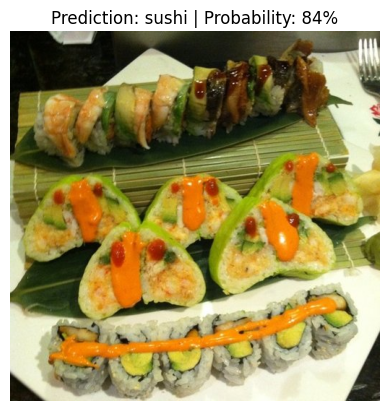

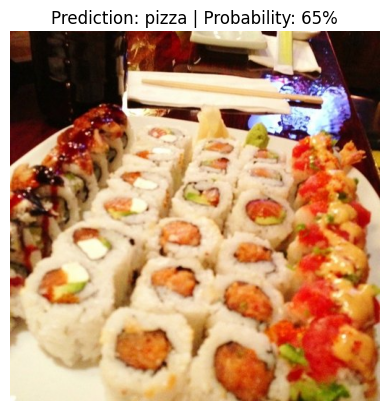

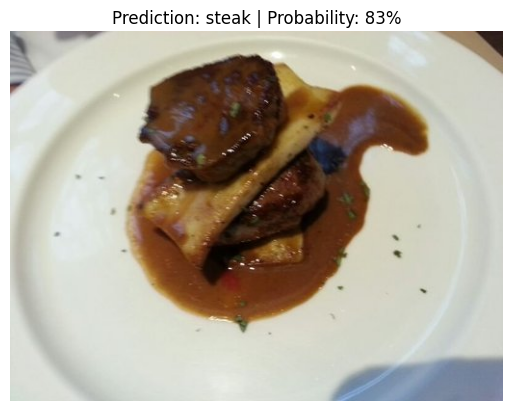

In [ ]:
rand_img = 3
test_img_path_list = list(Path(food_20_percent_path / "test").glob("*/*.jpg"))
img_path_list = random.sample(test_img_path_list, k=rand_img)

for img_path in img_path_list:

  predict_show_image_fn (model=best_model,
                          image_path=img_path,
                          class_names=class_names,
                           image_size = (224, 224))
  print(f"Predicting on {img_path.name}")

### 9.1 Predict on a custom image with the best model

In [ ]:
# Get data
data_path = "data"
custom_img_path = Path("data")/"sushi.jpg"

if not custom_img_path.is_file():
  with open(custom_img_path, "wb") as f:
    print(f"Downloading {custom_img_path}")
    request = requests.get("https://raw.githubusercontent.com/mrdbourke/pytorch-deep-learning/main/data/pizza_dad.jpeg")
    f.write(request.content)
else:
  print(f"{custom_img_path} already exists")

data/sushi.jpg already exists


In [ ]:
custom_img_path

PosixPath('data/sushi.jpg')

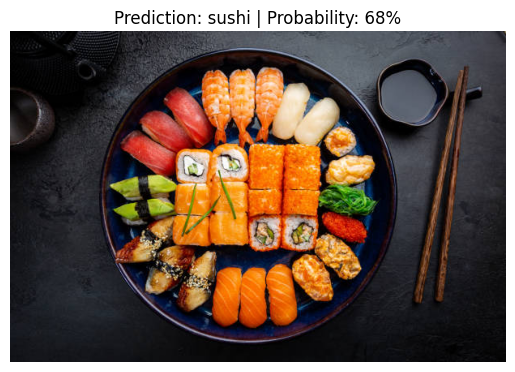

In [ ]:
auto_transforms = transforms.Compose([
  transforms.Resize(size=(224, 224)),
  transforms.ToTensor(),
  torchvision.models.EfficientNet_B0_Weights.IMAGENET1K_V1.transforms()
])
predict_show_image_fn (model=best_model,
                          image_path=custom_img_path,
                          class_names=class_names,
                       transform=auto_transforms)